In [1]:
%load_ext autoreload
%autoreload 2

import pymc as pm
import seaborn as sns
import pandas as pd
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)
import numpy as np
import arviz as az
from matplotlib import pyplot as plt

import sys
sys.path.append('..')
from pfas_prep import PFAS
from PyPKMC import PyPKMC
import register_pfas_data as rpd

In [2]:
chemical = 'PFNA'
pfas_db = '../PFAS.db'
pfas_tmp = PFAS(pfas_db, pfas_file = '../auxiliary/pfas_master.csv')#, hero_only=1289834) # 
Vdss_prior = {'mu': -1.5, 'sd': 1.5}
CLC_prior = {'mu': -2.89, 'sd': 2.68}
load_trace = False

# Rat fits

## Male

First import the data using the old PFAS class

In [3]:
%%time
pfas_male_data = pfas_tmp.get_processed_data(chemical=chemical, sex='Male', species='rat')
pfas_male_data.head()

Hero ID available:  [2919268 3858670 3859701 5063958]
dropping duplicated column
Hero ID used:  [2919268 3858670 3859701 5063958]
CPU times: user 245 ms, sys: 5.92 ms, total: 251 ms
Wall time: 250 ms


,hero_id,study_id,animal_id,N_animals,BW,BW_units,BW_init,BW_init_units,species,strain,dose,dose_units,time,time_units,conc_mean,conc_sd,standard_error,conc_units,route,matrix,sex,dtxsid,source,initial_age,initial_age_units,initial_weight,initial_weight_units,n,author,preferred_name,pfas_abbrev,casrn,iupac_name,mapped_dtxsid,n_times,idx1,idx2,idx3,time_cor,dose_cor,time_course,BW_cor,conc_mean_cor,conc_sd_cor,Dss,lod,censored,route_idx,sex_idx,lnconc_sd,lnconc_mean,cv,aidx,dose_mg,dataset_str
0,2919268,22,B4,1,292.0,g,0.286,g,rat,sprague-dawley,1.0,mg/kg,1.0,day,6470.0,0.0,0,ng/ml,gavage,serum,Male,DTXSID8031863,Lau_RawData,11.0,weeks,NaN,Indiv. Reported,1,Tatum-Gibbs,Perfluorononanoic acid,PFNA,375-95-1,"2,2,3,3,4,4,5,5,6,6,7,7,8,8,9,9,9-heptadecaflu...",DTXSID8031863,11,0,0,0,1.0,1.0,Indiv. Reported,0.292,6.41,0.0,0.0,-1,0,1,0,0.0,1.857859,0.0,True,0.286,2919268-1.0 mg/kg-gavage
1,2919268,22,B5,1,289.0,g,0.284,g,rat,sprague-dawley,1.0,mg/kg,1.0,day,6360.0,0.0,0,ng/ml,gavage,serum,Male,DTXSID8031863,Lau_RawData,11.0,weeks,NaN,Indiv. Reported,1,Tatum-Gibbs,Perfluorononanoic acid,PFNA,375-95-1,"2,2,3,3,4,4,5,5,6,6,7,7,8,8,9,9,9-heptadecaflu...",DTXSID8031863,11,0,0,0,1.0,1.0,Indiv. Reported,0.289,6.30,0.0,0.0,-1,0,1,0,0.0,1.840550,0.0,True,0.284,2919268-1.0 mg/kg-gavage
2,2919268,22,B6,1,287.0,g,0.283,g,rat,sprague-dawley,1.0,mg/kg,1.0,day,4840.0,0.0,0,ng/ml,gavage,serum,Male,DTXSID8031863,Lau_RawData,11.0,weeks,NaN,Indiv. Reported,1,Tatum-Gibbs,Perfluorononanoic acid,PFNA,375-95-1,"2,2,3,3,4,4,5,5,6,6,7,7,8,8,9,9,9-heptadecaflu...",DTXSID8031863,11,0,0,0,1.0,1.0,Indiv. Reported,0.287,4.78,0.0,0.0,-1,0,1,0,0.0,1.564441,0.0,True,0.283,2919268-1.0 mg/kg-gavage
3,2919268,22,B4,1,292.0,g,0.286,g,rat,sprague-dawley,1.0,mg/kg,2.0,day,5010.0,0.0,0,ng/ml,gavage,serum,Male,DTXSID8031863,Lau_RawData,11.0,weeks,NaN,Indiv. Reported,1,Tatum-Gibbs,Perfluorononanoic acid,PFNA,375-95-1,"2,2,3,3,4,4,5,5,6,6,7,7,8,8,9,9,9-heptadecaflu...",DTXSID8031863,11,0,0,0,2.0,1.0,Indiv. Reported,0.292,4.95,0.0,0.0,-1,0,1,0,0.0,1.599388,0.0,True,0.286,2919268-1.0 mg/kg-gavage
4,2919268,22,B5,1,291.0,g,0.284,g,rat,sprague-dawley,1.0,mg/kg,2.0,day,5290.0,0.0,0,ng/ml,gavage,serum,Male,DTXSID8031863,Lau_RawData,11.0,weeks,NaN,Indiv. Reported,1,Tatum-Gibbs,Perfluorononanoic acid,PFNA,375-95-1,"2,2,3,3,4,4,5,5,6,6,7,7,8,8,9,9,9-heptadecaflu...",DTXSID8031863,11,0,0,0,2.0,1.0,Indiv. Reported,0.291,5.23,0.0,0.0,-1,0,1,0,0.0,1.654411,0.0,True,0.284,2919268-1.0 mg/kg-gavage


### Run the models

#### 1-Compartment model

In [4]:
pfas_male_1cmpt = PyPKMC(pfas_male_data, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_male_1cmpt.sample(model_type='1-compartment', target_accept=0.99, nuts_sampler='numpyro',
                   load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFNA_Male_rat_1cmpt
hierarchical model, 1-compartment


Sampling: [conc_indiv, conc_summary, fa, kappaMinusTwo, lnCLC_offset, lnVd_offset, lnk_abs_offset, mu_fa, mu_lnCLC, mu_lnVd, mu_lnk_abs, sigma, sigma_lnCLC, sigma_lnVd, sigma_lnk_abs]


  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

2024-08-14 14:03:06.546368: E external/xla/xla/service/slow_operation_alarm.cc:65] Constant folding an instruction is taking > 1s:

  %reduce = f64[4,5000,131]{2,1,0} reduce(f64[4,5000,1,131]{3,2,1,0} %broadcast.34, f64[] %constant.40), dimensions={2}, to_apply=%region_1.99, metadata={op_name="jit(process_fn)/jit(main)/reduce_prod[axes=(2,)]" source_file="/data/tzurlind/tmp/tmpc_faz6x_" source_line=59}

This isn't necessarily a bug; constant-folding is inherently a trade-off between compilation time and speed at runtime. XLA has some guards that attempt to keep constant folding from taking too long, but fundamentally you'll always be able to come up with an input program that takes a long time.

If you'd like to file a bug, run with envvar XLA_FLAGS=--xla_dump_to=/tmp/foo and attach the results.
2024-08-14 14:03:14.906142: E external/xla/xla/service/slow_operation_alarm.cc:133] The operation took 9.359920765s
Constant folding an instruction is taking > 1s:

  %reduce = f64[4,5000,131]{

Output()

Combining likelihoods...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


Checking metrics...
Pass all metrics = True
Assign pareto...


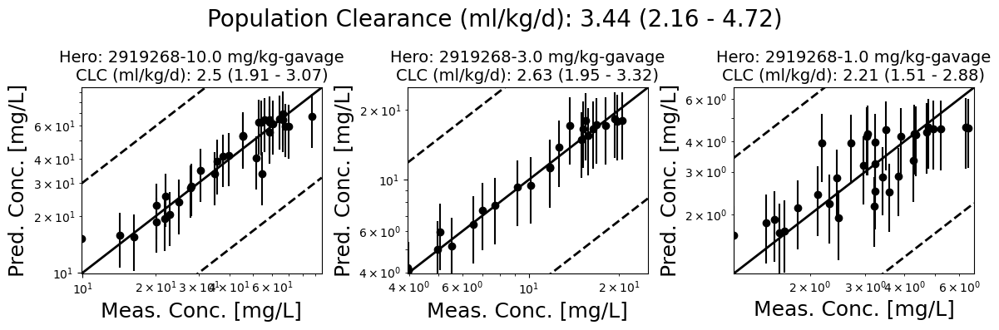

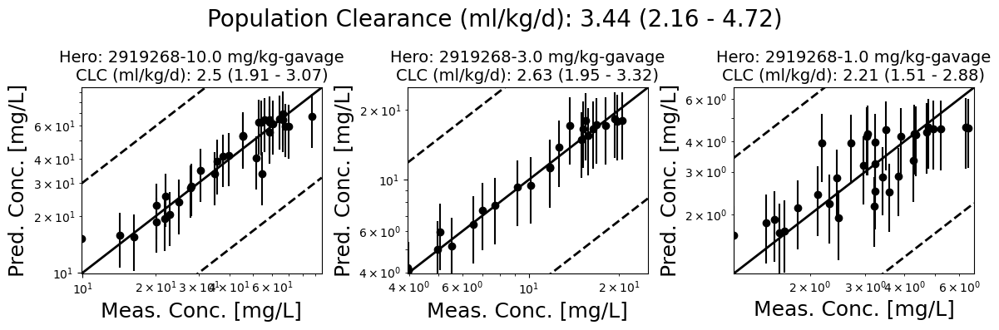

In [5]:
pfas_male_1cmpt._study_ppc(2919268, continuous=False)

In [6]:
indiv_summary = pfas_male_1cmpt.get_pk_stats(level='indiv', vol_units='ml')
hero_id = '3858670'
pk_parm = 'halft'
dose = '10.0 mg/kg'
#hero_fits = indiv_summary.loc[[x for x in indiv_summary.index if (hero_id in x) & (pk_parm in x)]]
hero_fits = indiv_summary.loc[[x for x in indiv_summary.index if (hero_id in x)]]# & (dose in x)]]
for ind, row in hero_fits.iterrows():
    print(ind, "%0.4g (%0.4g - %0.4g)"%(row['mean'], row['hdi_5%'], row['hdi_95%']))

CLC [indiv][3858670-22.57 mg/kg-iv] 6.64 (4.73 - 8.62)
Vdss [indiv][3858670-22.57 mg/kg-iv] 275.3 (235 - 315.3)
abs_halft [indiv][3858670-22.57 mg/kg-iv] 0.02002 (0.00073 - 0.04172)
fa [indiv][3858670-22.57 mg/kg-iv] 0.6959 (0.3024 - 1)
halft [indiv][3858670-22.57 mg/kg-iv] 30.76 (19.64 - 40.67)
halft_beta [indiv][3858670-22.57 mg/kg-iv] 30.76 (19.64 - 40.67)


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (45), generating only 20 plots
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


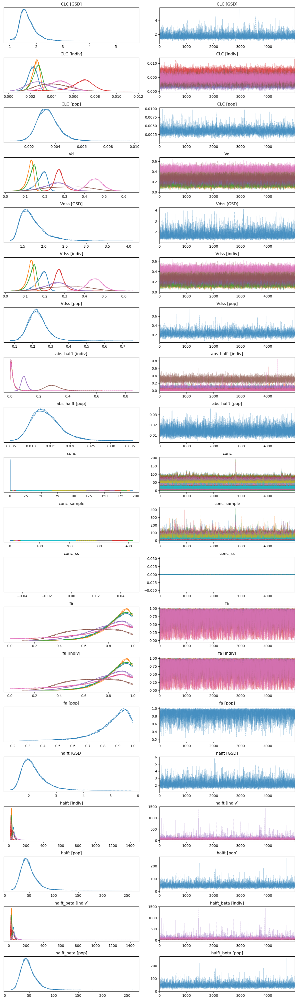

In [7]:
with pfas_male_1cmpt.model:
    az.plot_trace(pfas_male_1cmpt._trace)
    plt.tight_layout()

conc_indiv
conc_summary


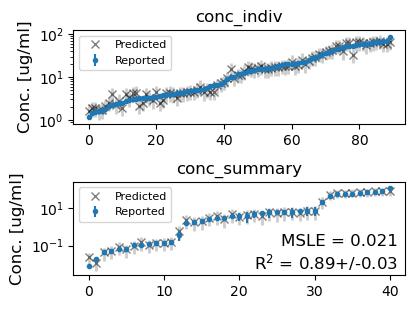

In [8]:
pfas_male_1cmpt.plot_data_ppc(group='posterior')

#### 2-Compartment model

In [9]:
pfas_male_2cmpt = PyPKMC(pfas_male_data, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx', 
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_male_2cmpt.sample(model_type='2-compartment', target_accept=0.999, nuts_sampler='numpyro',
                   load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)
                       #load_trace=load_trace, tune=2000, draws=2000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFNA_Male_rat_2cmpt
hierarchical model, 2-compartment


Sampling: [conc_indiv, conc_summary, fa, kappaMinusTwo, lnCLC_offset, lnR_offset, lnVdss_offset, lnk_abs_offset, lnk_cd_offset, mu_fa, mu_lnCLC, mu_lnR, mu_lnVdss, mu_lnk_abs, mu_lnk_cd, sigma, sigma_lnCLC, sigma_lnR, sigma_lnVdss, sigma_lnk_abs, sigma_lnk_cd]


  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

Sampling: [conc_indiv, conc_summary]


Output()

Combining likelihoods...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:1024: RuntimeWarning: overflow encountered in exp
  weights = 1 / np.exp(len_scale - len_scale[:, None]).sum(axis=1)
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


Checking metrics...
Pass all metrics = True
Assign pareto...


In [10]:
indiv_summary = pfas_male_2cmpt.get_pk_stats(level='indiv', vol_units='ml')
hero_id = '2919268'
pk_parm = 'halft_beta'
dose = '1.0 mg/kg'
#hero_fits = indiv_summary.loc[[x for x in indiv_summary.index if (hero_id in x) & (pk_parm in x)]]
hero_fits = indiv_summary.loc[[x for x in indiv_summary.index if (hero_id in x) & (dose in x)]]
for ind, row in hero_fits.iterrows():
    print(ind, "%0.4g (%0.4g - %0.4g)"%(row['mean'], row['hdi_5%'], row['hdi_95%']))

CLC [indiv][2919268-1.0 mg/kg-gavage] 2.05 (1.29 - 2.77)
Vdss [indiv][2919268-1.0 mg/kg-gavage] 191 (139.3 - 236.9)
abs_halft [indiv][2919268-1.0 mg/kg-gavage] 0.02017 (0.00069 - 0.04314)
fa [indiv][2919268-1.0 mg/kg-gavage] 0.8402 (0.6696 - 1)
halft [indiv][2919268-1.0 mg/kg-gavage] 67.5 (43.81 - 88.92)
halft_alpha [indiv][2919268-1.0 mg/kg-gavage] 2.636 (0.00018 - 3.466)
halft_beta [indiv][2919268-1.0 mg/kg-gavage] 72.34 (43.66 - 90.64)


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (83), generating only 20 plots
  warnings.warn(


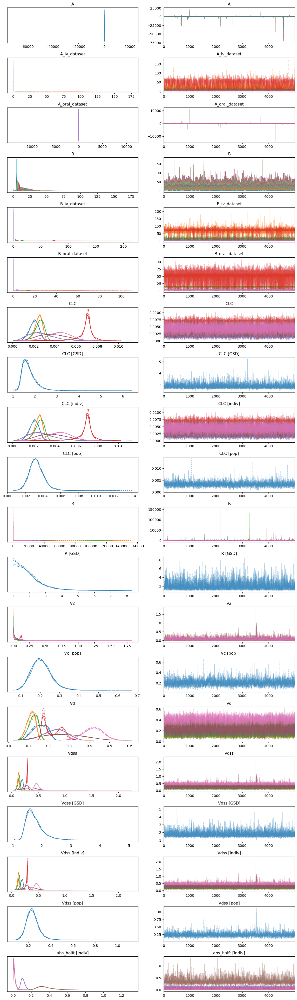

In [11]:
with pfas_male_2cmpt.model:
    az.plot_trace(pfas_male_2cmpt._trace)
    plt.tight_layout()

conc_indiv
conc_summary


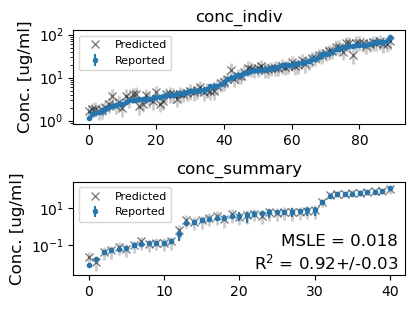

In [12]:
pfas_male_2cmpt.plot_data_ppc(group='posterior')

#### Compare models

/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:1024: RuntimeWarning: overflow encountered in exp
  weights = 1 / np.exp(len_scale - len_scale[:, None]).sum(axis=1)
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal poster

,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
2_compartment,0,-352.436359,47.332862,0.000000,1.000000e+00,42.479980,0.000000,True,log
1_compartment,1,-357.933013,38.184984,5.496654,2.486900e-14,42.824922,2.122972,True,log


<Axes: title={'center': 'Model comparison\nhigher is better'}, xlabel='elpd_loo (log)', ylabel='ranked models'>

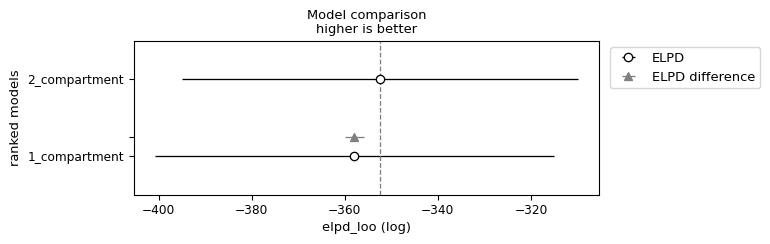

In [13]:
pfas_male_compare = az.compare({"1_compartment": pfas_male_1cmpt._trace, "2_compartment": pfas_male_2cmpt._trace},
                           var_name="combined",ic='loo')
display(pfas_male_compare)
az.plot_compare(pfas_male_compare, insample_dev=False)

#### Define winning model

In [70]:
#print('1-cmpt r2 metrics: ', pfas_male_1cmpt.bayes_r2)
print('2-cmpt r2 metrics: ', pfas_male_2cmpt.bayes_r2)
pfas_male = pfas_male_2cmpt 
print(pfas_male.N_divergences)
print(f'Pass all metrics = {pfas_male_2cmpt.pass_all_metrics}')

2-cmpt r2 metrics:  r2        0.922027
r2_std    0.031862
dtype: float64
0
Pass all metrics = True


### Posterior predictive check on winning model

conc_indiv
conc_summary
conc_indiv
conc_summary


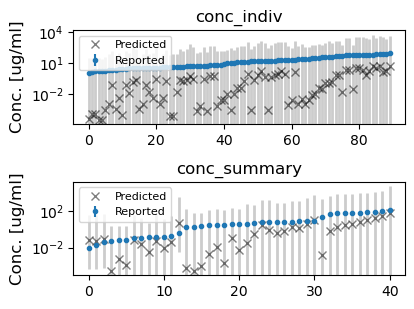

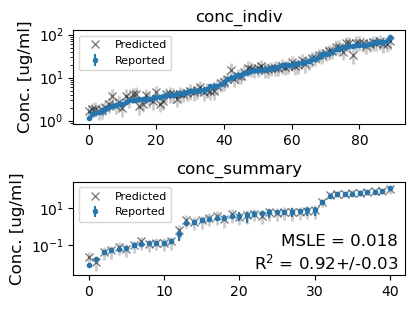

In [15]:
pfas_male.plot_data_ppc(group='prior', savefig=True)
pfas_male.plot_data_ppc(group='posterior', savefig=True)

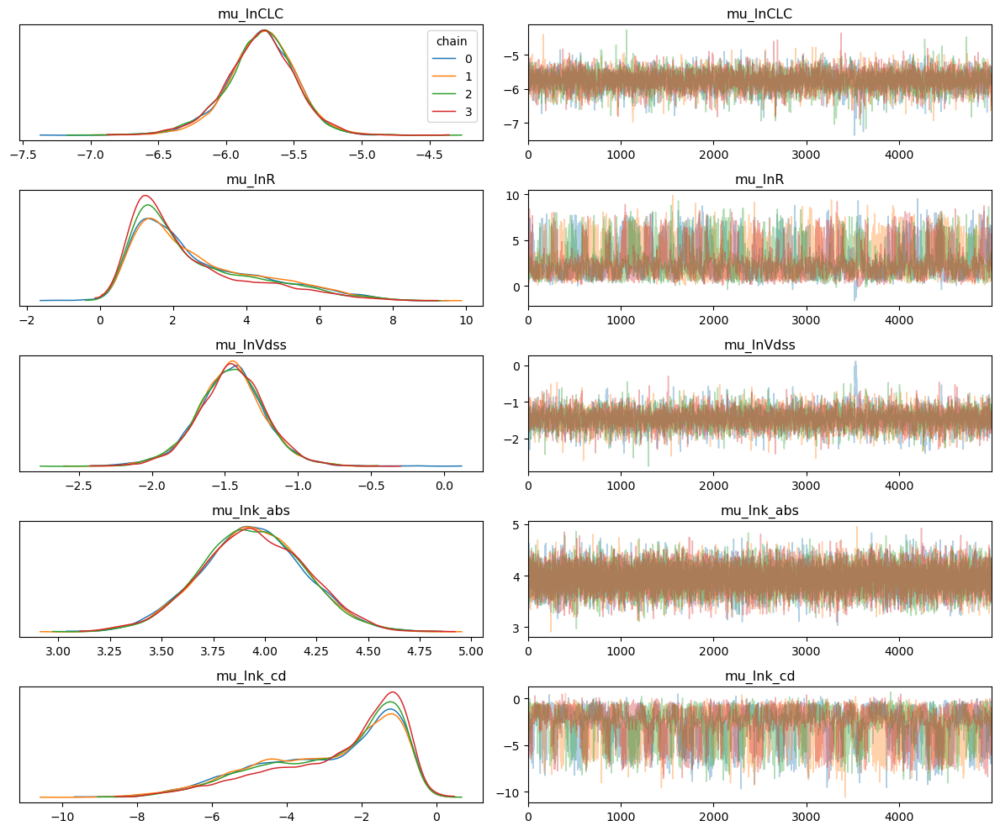

In [16]:
trace_model = pfas_male
with trace_model.model:
    if trace_model.model_structure == 'hierarchical':
        az.plot_trace(trace_model._trace, var_names=['^mu_ln'], filter_vars='regex', compact=False, legend=True)
    else:
        az.plot_trace(trace_model._trace, var_names=['^ln(?!conc).*$'], filter_vars='regex', compact=False, legend=True)
    plt.tight_layout()
    plt.savefig('../ppc/traceplots/%s_%s_%s_traceplot.png'% (trace_model.chemical, trace_model.species, trace_model.sex))

../species_fits/rat/PFNA/PFNA_Male_rat_CLC_2cmpt.pdf
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...


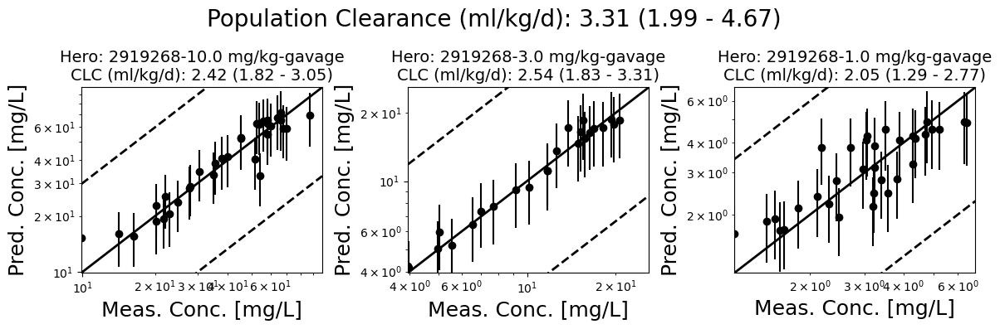

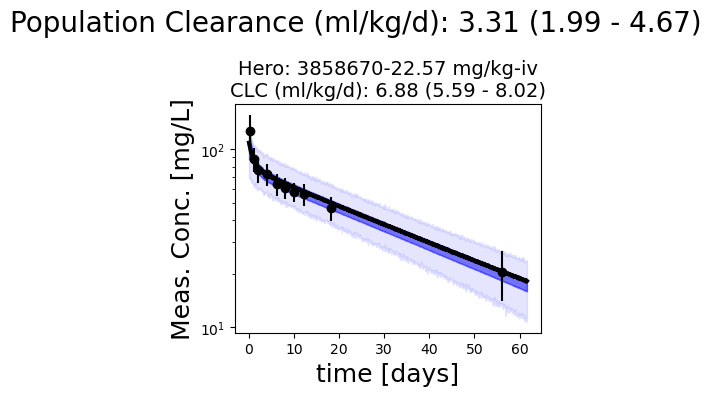

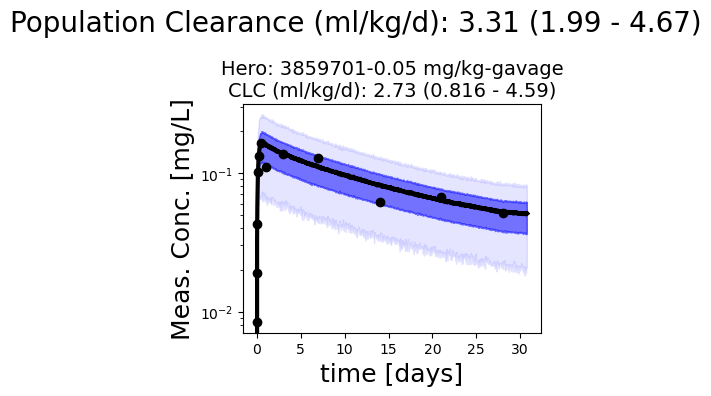

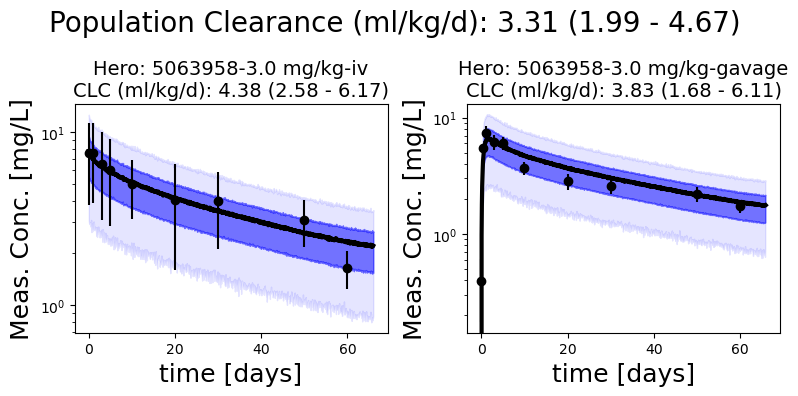

In [17]:
pfas_male.plot_all_studies(hero_unity=[2919268])

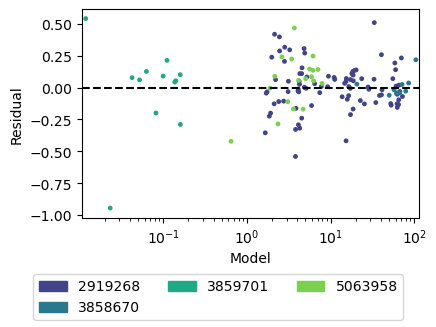

In [18]:
pfas_male.plot_residuals()

### PK stats

In [19]:
pfas_male.get_pk_stats() # New

,mean,sd,hdi_5%,hdi_95%
CLC [pop],0.00330,0.00087,0.00199,0.00467
Vc [pop],0.20644,0.05344,0.11891,0.28419
Vdss [pop],0.23975,0.06103,0.15061,0.33108
abs_halft [pop],0.01389,0.00354,0.00822,0.01932
fa [pop],0.86261,0.10871,0.71514,0.99943
halft [pop],53.72170,22.91033,25.10438,79.35830
halft_alpha [pop],2.25425,5.71341,0.00023,4.23716
halft_beta [pop],55.43671,47.32895,25.19854,81.25470


## Female

In [20]:
%%time
pfas_female_data = pfas_tmp.get_processed_data(chemical=chemical, sex='Female', species='rat')
pfas_female_data.head()

Hero ID available:  [2919268 3858670 3859701 5063958]
dropping duplicated column
Hero ID used:  [2919268 3858670 5063958]
CPU times: user 312 ms, sys: 9.76 ms, total: 321 ms
Wall time: 321 ms


,hero_id,study_id,animal_id,N_animals,BW,BW_units,BW_init,BW_init_units,species,strain,dose,dose_units,time,time_units,conc_mean,conc_sd,standard_error,conc_units,route,matrix,sex,dtxsid,source,initial_age,initial_age_units,initial_weight,initial_weight_units,n,author,preferred_name,pfas_abbrev,casrn,iupac_name,mapped_dtxsid,n_times,idx1,idx2,idx3,time_cor,dose_cor,time_course,BW_cor,conc_mean_cor,conc_sd_cor,Dss,lod,censored,route_idx,sex_idx,lnconc_sd,lnconc_mean,cv,aidx,dose_mg,dataset_str
0,2919268,23,B1,1,259.0,g,0.261,g,rat,sprague-dawley,1.0,mg/kg,1.0,day,5570.0,0.0,0,ng/ml,gavage,serum,Female,DTXSID8031863,Lau_RawData,11.0,weeks,NaN,Indiv. Reported,1,Tatum-Gibbs,Perfluorononanoic acid,PFNA,375-95-1,"2,2,3,3,4,4,5,5,6,6,7,7,8,8,9,9,9-heptadecaflu...",DTXSID8031863,11,0,0,0,1.0,1.0,Indiv. Reported,0.259,5.570,0.0,0.000218,-1,0,1,1,0.0,1.717395,0.0,True,0.261,2919268-1.0 mg/kg-gavage
1,2919268,23,B2,1,258.0,g,0.259,g,rat,sprague-dawley,1.0,mg/kg,1.0,day,4735.0,0.0,0,ng/ml,gavage,serum,Female,DTXSID8031863,Lau_RawData,11.0,weeks,NaN,Indiv. Reported,1,Tatum-Gibbs,Perfluorononanoic acid,PFNA,375-95-1,"2,2,3,3,4,4,5,5,6,6,7,7,8,8,9,9,9-heptadecaflu...",DTXSID8031863,11,0,0,0,1.0,1.0,Indiv. Reported,0.258,4.735,0.0,0.000218,-1,0,1,1,0.0,1.554982,0.0,True,0.259,2919268-1.0 mg/kg-gavage
2,2919268,23,B3,1,266.0,g,0.261,g,rat,sprague-dawley,1.0,mg/kg,1.0,day,5550.0,0.0,0,ng/ml,gavage,serum,Female,DTXSID8031863,Lau_RawData,11.0,weeks,NaN,Indiv. Reported,1,Tatum-Gibbs,Perfluorononanoic acid,PFNA,375-95-1,"2,2,3,3,4,4,5,5,6,6,7,7,8,8,9,9,9-heptadecaflu...",DTXSID8031863,11,0,0,0,1.0,1.0,Indiv. Reported,0.266,5.550,0.0,0.000218,-1,0,1,1,0.0,1.713798,0.0,True,0.261,2919268-1.0 mg/kg-gavage
3,2919268,23,B1,1,268.0,g,0.261,g,rat,sprague-dawley,1.0,mg/kg,2.0,day,3470.0,0.0,0,ng/ml,gavage,serum,Female,DTXSID8031863,Lau_RawData,11.0,weeks,NaN,Indiv. Reported,1,Tatum-Gibbs,Perfluorononanoic acid,PFNA,375-95-1,"2,2,3,3,4,4,5,5,6,6,7,7,8,8,9,9,9-heptadecaflu...",DTXSID8031863,11,0,0,0,2.0,1.0,Indiv. Reported,0.268,3.470,0.0,0.000218,-1,0,1,1,0.0,1.244155,0.0,True,0.261,2919268-1.0 mg/kg-gavage
4,2919268,23,B2,1,266.0,g,0.259,g,rat,sprague-dawley,1.0,mg/kg,2.0,day,2730.0,0.0,0,ng/ml,gavage,serum,Female,DTXSID8031863,Lau_RawData,11.0,weeks,NaN,Indiv. Reported,1,Tatum-Gibbs,Perfluorononanoic acid,PFNA,375-95-1,"2,2,3,3,4,4,5,5,6,6,7,7,8,8,9,9,9-heptadecaflu...",DTXSID8031863,11,0,0,0,2.0,1.0,Indiv. Reported,0.266,2.730,0.0,0.000218,-1,0,1,1,0.0,1.004302,0.0,True,0.259,2919268-1.0 mg/kg-gavage


### Run the models

#### 1-Compartment model

In [21]:
pfas_female_1cmpt = PyPKMC(pfas_female_data, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_female_1cmpt.sample(model_type='1-compartment', target_accept=0.99, nuts_sampler='numpyro',
                   load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFNA_Female_rat_1cmpt
hierarchical model, 1-compartment


Sampling: [conc_indiv, conc_summary, fa, kappaMinusTwo, lnCLC_offset, lnVd_offset, lnk_abs_offset, mu_fa, mu_lnCLC, mu_lnVd, mu_lnk_abs, sigma, sigma_lnCLC, sigma_lnVd, sigma_lnk_abs]


  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

Sampling: [conc_indiv, conc_summary]


Output()

Combining likelihoods...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (45), generating only 20 plots
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


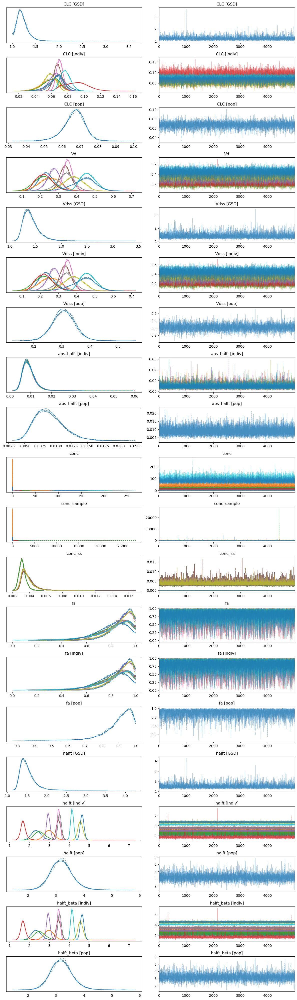

In [22]:
with pfas_female_1cmpt.model:
    az.plot_trace(pfas_female_1cmpt._trace)
    plt.tight_layout()

conc_indiv
conc_summary


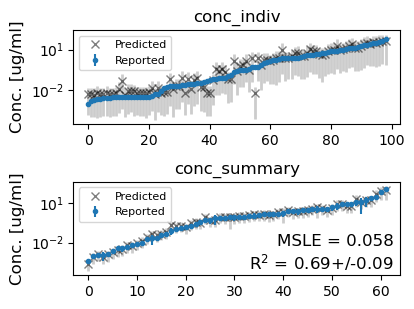

In [23]:
pfas_female_1cmpt.plot_data_ppc(group='posterior')

#### 2-Compartment model

In [24]:
pfas_female_2cmpt = PyPKMC(pfas_female_data, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_female_2cmpt.sample(model_type='2-compartment', target_accept=0.999, nuts_sampler='numpyro',
                   load_trace=load_trace, tune=15000, draws=7000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFNA_Female_rat_2cmpt
hierarchical model, 2-compartment


Sampling: [conc_indiv, conc_summary, fa, kappaMinusTwo, lnCLC_offset, lnR_offset, lnVdss_offset, lnk_abs_offset, lnk_cd_offset, mu_fa, mu_lnCLC, mu_lnR, mu_lnVdss, mu_lnk_abs, mu_lnk_cd, sigma, sigma_lnCLC, sigma_lnR, sigma_lnVdss, sigma_lnk_abs, sigma_lnk_cd]


  0%|          | 0/22000 [00:00<?, ?it/s]

  0%|          | 0/22000 [00:00<?, ?it/s]

  0%|          | 0/22000 [00:00<?, ?it/s]

  0%|          | 0/22000 [00:00<?, ?it/s]

Sampling: [conc_indiv, conc_summary]


Output()

Combining likelihoods...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


Checking metrics...
Pass all metrics = True
Assign pareto...


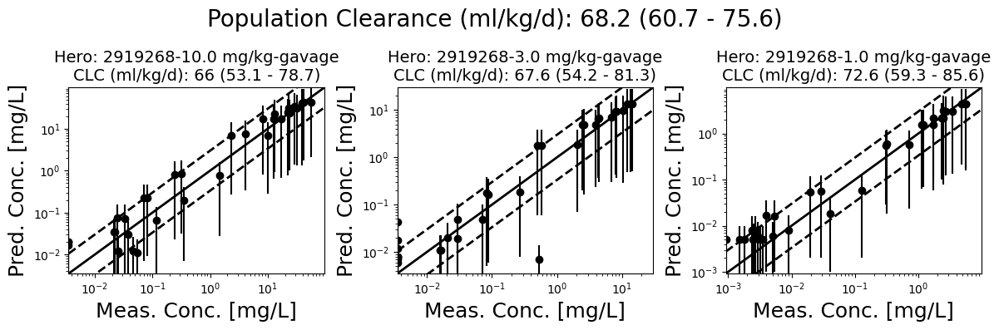

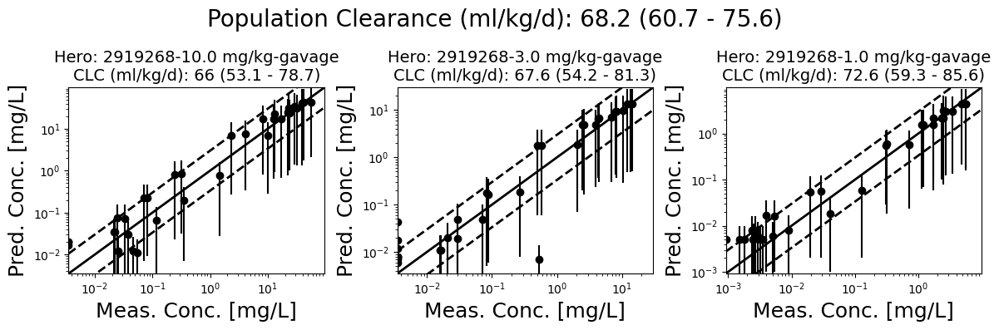

In [25]:
pfas_female_2cmpt._study_ppc(2919268, continuous=False)

In [26]:
indiv_summary = pfas_female_2cmpt.get_pk_stats(level='indiv', vol_units='ml')
hero_id = '3858670'
pk_parm = 'halft ['
dose = '10.0 mg/kg'
#hero_fits = indiv_summary.loc[[x for x in indiv_summary.index if (hero_id in x) & (pk_parm in x)]]
hero_fits = indiv_summary.loc[[x for x in indiv_summary.index if (hero_id in x)]]# & (dose in x)]]
for ind, row in hero_fits.iterrows():
    print(ind, "%0.4g (%0.4g - %0.4g)"%(row['mean'], row['hdi_5%'], row['hdi_95%']))

CLC [indiv][3858670-22.57 mg/kg-iv] 88.54 (65.85 - 108.5)
Vdss [indiv][3858670-22.57 mg/kg-iv] 223.7 (149.4 - 291.4)
abs_halft [indiv][3858670-22.57 mg/kg-iv] 0.0106 (0.00469 - 0.01603)
fa [indiv][3858670-22.57 mg/kg-iv] 0.8529 (0.6851 - 0.9999)
halft [indiv][3858670-22.57 mg/kg-iv] 1.748 (1.461 - 2.002)
halft_alpha [indiv][3858670-22.57 mg/kg-iv] 1.572 (1.296 - 1.823)
halft_beta [indiv][3858670-22.57 mg/kg-iv] 6.904 (1.754 - 10.27)


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (83), generating only 20 plots
  warnings.warn(


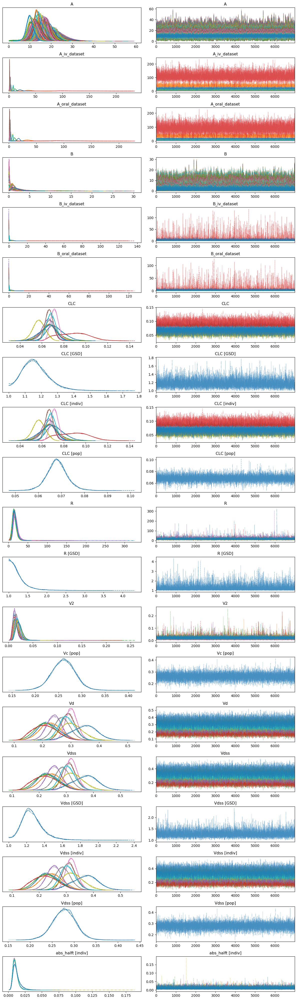

In [27]:
with pfas_female_2cmpt.model:
    az.plot_trace(pfas_female_2cmpt._trace)
    plt.tight_layout()

conc_indiv
conc_summary


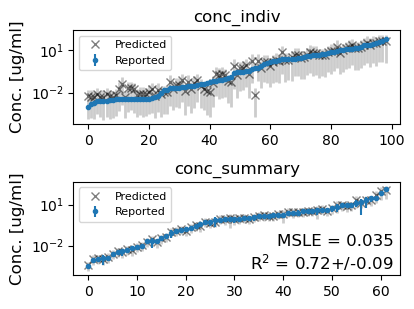

In [28]:
pfas_female_2cmpt.plot_data_ppc(group='posterior')

#### Compare models

/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
2_compartment,0,269.085243,48.368100,0.000000,0.858454,122.527989,0.000000,True,log
1_compartment,1,206.273816,51.654183,62.811427,0.141546,117.650777,19.572531,True,log


<Axes: title={'center': 'Model comparison\nhigher is better'}, xlabel='elpd_loo (log)', ylabel='ranked models'>

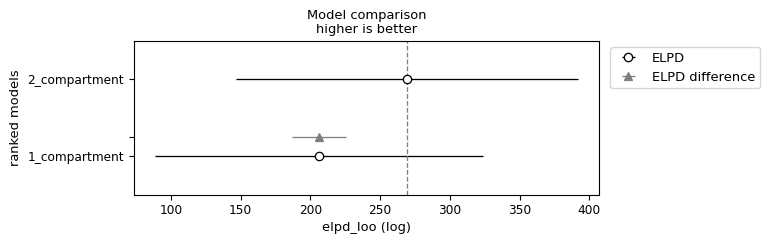

In [29]:
pfas_female_compare = az.compare({"1_compartment": pfas_female_1cmpt._trace, "2_compartment": pfas_female_2cmpt._trace},
                           var_name="combined",ic='loo')
display(pfas_female_compare)
az.plot_compare(pfas_female_compare, insample_dev=False)

#### Define winning model

In [71]:
pfas_female = pfas_female_2cmpt
print(pfas_female.N_divergences)
print(f'Pass all metrics = {pfas_female_2cmpt.pass_all_metrics}')

0
Pass all metrics = True


### Posterior predictive check on winning model

conc_indiv
conc_summary
conc_indiv
conc_summary


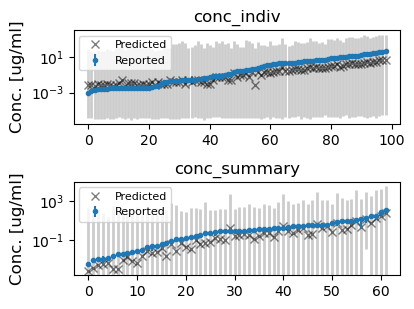

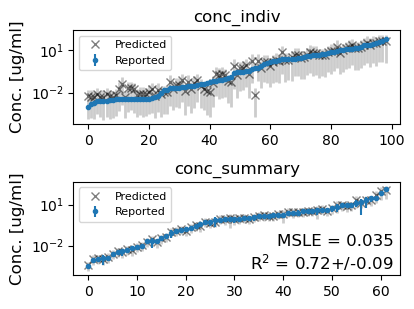

In [31]:
pfas_female.plot_data_ppc(group='prior', savefig=True)
pfas_female.plot_data_ppc(group='posterior', savefig=True)

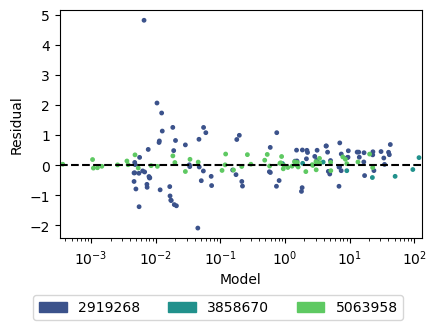

In [32]:
pfas_female.plot_residuals() 

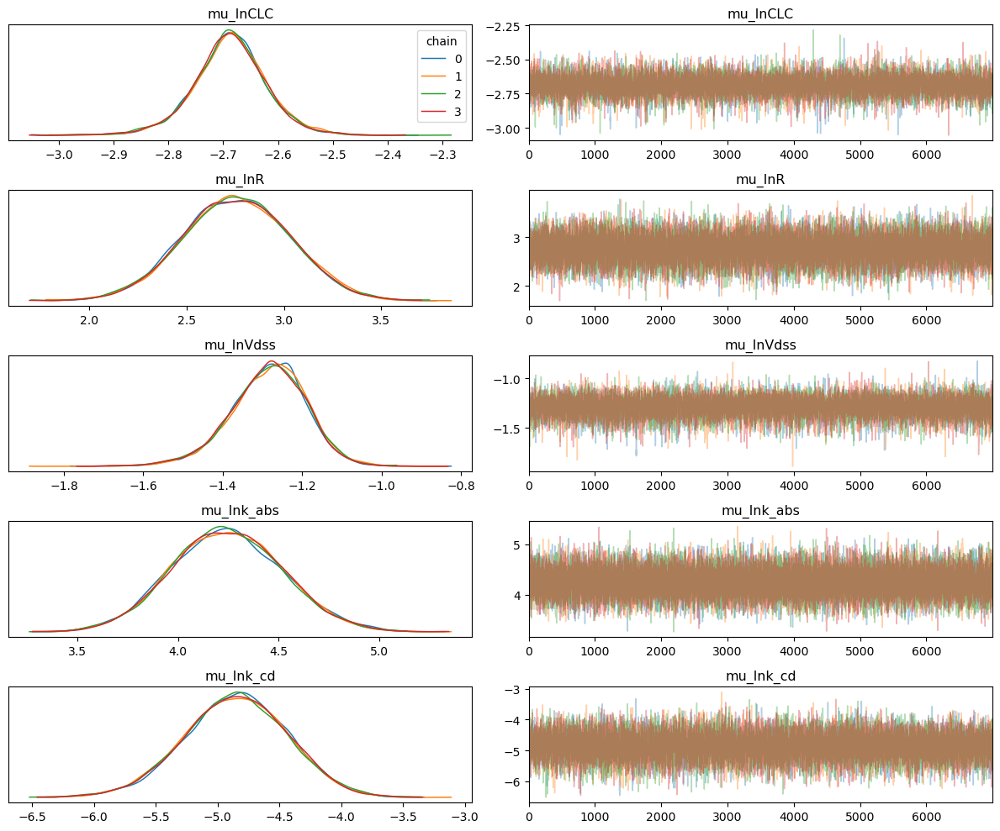

In [33]:
trace_model = pfas_female
with trace_model.model:
    if trace_model.model_structure == 'hierarchical':
        az.plot_trace(trace_model._trace, var_names=['^mu_ln'], filter_vars='regex', compact=False, legend=True)
    else:
        az.plot_trace(trace_model._trace, var_names=['^ln(?!conc).*$'], filter_vars='regex', compact=False, legend=True)
    plt.tight_layout()
    plt.savefig('../ppc/traceplots/%s_%s_%s_traceplot.png'% (trace_model.chemical, trace_model.species, trace_model.sex))

../species_fits/rat/PFNA/PFNA_Female_rat_CLC_2cmpt.pdf
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...


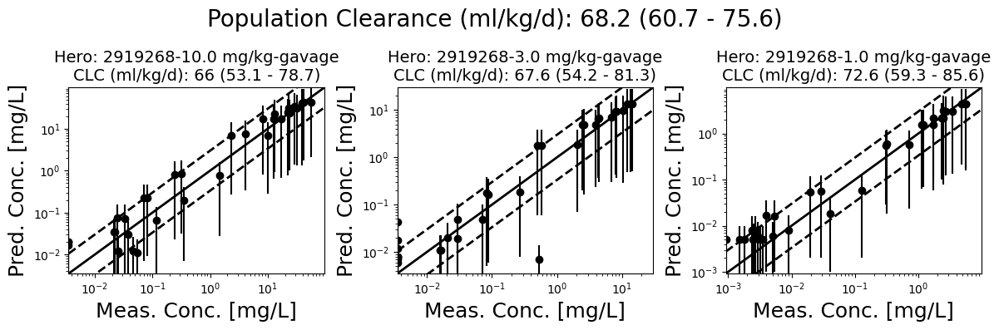

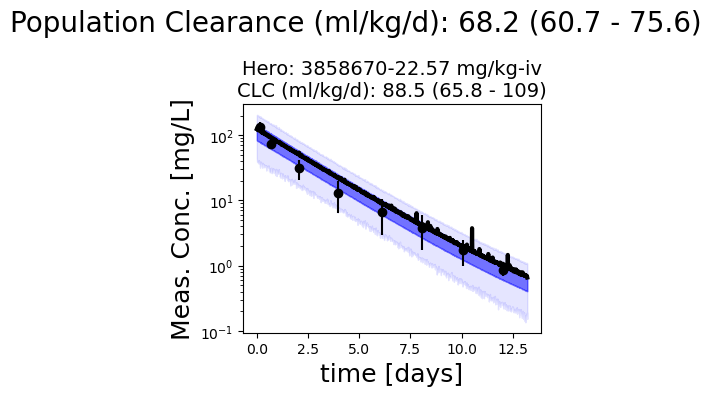

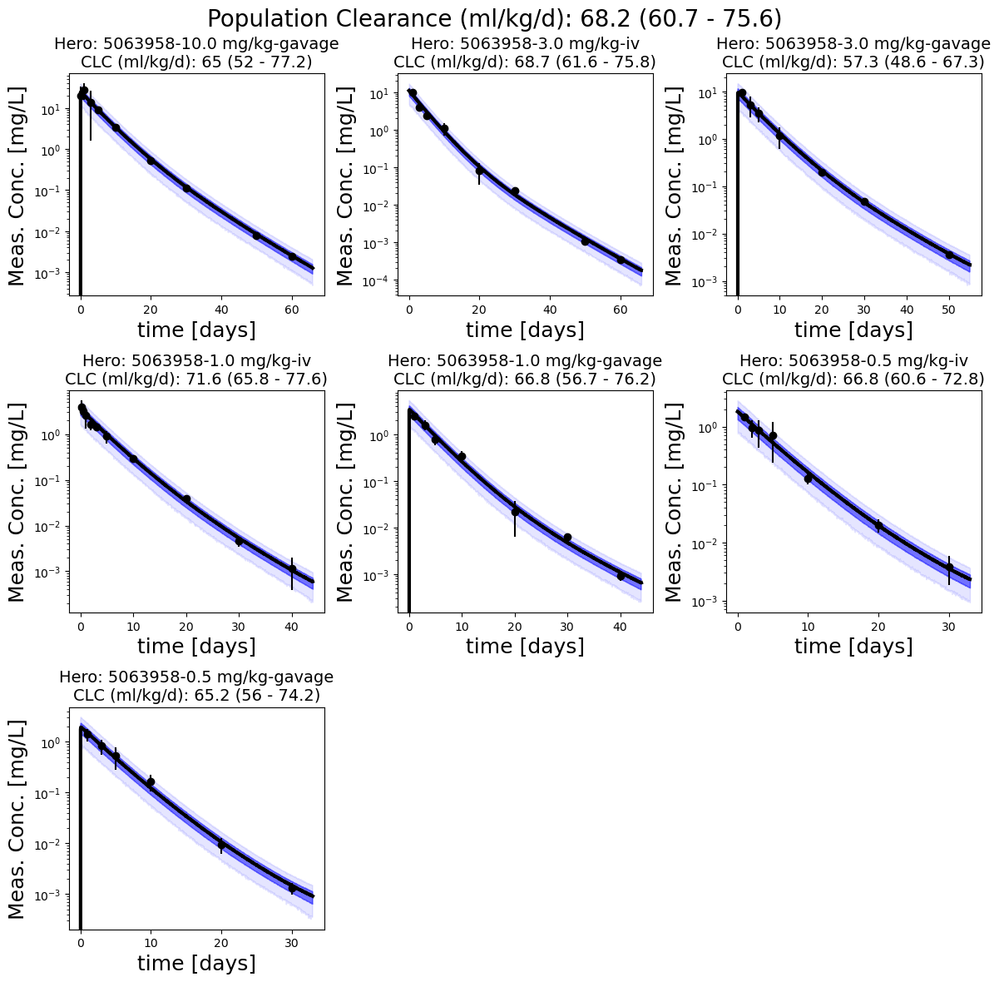

In [34]:
pfas_female.plot_all_studies(hero_unity=[2919268])

### PK stats

In [35]:
pfas_female.get_pk_stats(vol_units='ml') ##

,mean,sd,hdi_5%,hdi_95%
CLC [pop],68.17000,4.60000,60.67000,75.63000
Vc [pop],0.26070,0.02556,0.21955,0.30197
Vdss [pop],277.79000,26.54000,234.01000,319.68000
abs_halft [pop],0.01032,0.00284,0.00579,0.01467
fa [pop],0.93690,0.05017,0.87172,0.99942
halft [pop],2.83082,0.26797,2.39838,3.26442
halft_alpha [pop],2.49922,0.25373,2.07629,2.90104
halft_beta [pop],6.19292,1.74998,3.99404,8.31828


# Mouse

## Male

In [36]:
%%time
pfas_male_data_mouse = pfas_tmp.get_processed_data(chemical=chemical, sex='Male', species='mouse')
pfas_male_data_mouse.head()

Hero ID available:  [2919268 3858670 3859701 5063958]
dropping duplicated column
Hero ID used:  [2919268]
CPU times: user 88.9 ms, sys: 2.79 ms, total: 91.7 ms
Wall time: 91.1 ms


,hero_id,study_id,animal_id,N_animals,BW,BW_units,BW_init,BW_init_units,species,strain,dose,dose_units,time,time_units,conc_mean,conc_sd,standard_error,conc_units,route,matrix,sex,dtxsid,source,initial_age,initial_age_units,initial_weight,initial_weight_units,n,author,preferred_name,pfas_abbrev,casrn,iupac_name,mapped_dtxsid,n_times,idx1,idx2,idx3,time_cor,dose_cor,BW_cor,conc_mean_cor,conc_sd_cor,Dss,lod,censored,route_idx,sex_idx,lnconc_sd,lnconc_mean,cv,aidx,dose_mg,dataset_str
0,2919268,24,7971,1,34.8,g,0.0343,g,mouse,CD-1,1.0,mg/kg,1.0,day,2210.0,0.0,0,ng/ml,gavage,serum,Male,DTXSID8031863,Lau_RawData,9.0,weeks,NaN,Indiv. Reported,1,Tatum-Gibbs,Perfluorononanoic acid,PFNA,375-95-1,"2,2,3,3,4,4,5,5,6,6,7,7,8,8,9,9,9-heptadecaflu...",DTXSID8031863,10,0,0,0,1.0,1.0,0.0348,2.20445,0.0,0.0,-1,0,1,0,0.0,0.790478,0.0,True,0.0343,2919268-1.0 mg/kg-gavage
1,2919268,24,7972,1,33.0,g,0.0322,g,mouse,CD-1,1.0,mg/kg,1.0,day,2170.0,0.0,0,ng/ml,gavage,serum,Male,DTXSID8031863,Lau_RawData,9.0,weeks,NaN,Indiv. Reported,1,Tatum-Gibbs,Perfluorononanoic acid,PFNA,375-95-1,"2,2,3,3,4,4,5,5,6,6,7,7,8,8,9,9,9-heptadecaflu...",DTXSID8031863,10,0,0,0,1.0,1.0,0.0330,2.16445,0.0,0.0,-1,0,1,0,0.0,0.772166,0.0,True,0.0322,2919268-1.0 mg/kg-gavage
2,2919268,24,7973,1,34.6,g,0.0344,g,mouse,CD-1,1.0,mg/kg,1.0,day,1720.0,0.0,0,ng/ml,gavage,serum,Male,DTXSID8031863,Lau_RawData,9.0,weeks,NaN,Indiv. Reported,1,Tatum-Gibbs,Perfluorononanoic acid,PFNA,375-95-1,"2,2,3,3,4,4,5,5,6,6,7,7,8,8,9,9,9-heptadecaflu...",DTXSID8031863,10,0,0,0,1.0,1.0,0.0346,1.71445,0.0,0.0,-1,0,1,0,0.0,0.539092,0.0,True,0.0344,2919268-1.0 mg/kg-gavage
3,2919268,24,7974,1,34.2,g,0.0334,g,mouse,CD-1,1.0,mg/kg,1.0,day,2390.0,0.0,0,ng/ml,gavage,serum,Male,DTXSID8031863,Lau_RawData,9.0,weeks,NaN,Indiv. Reported,1,Tatum-Gibbs,Perfluorononanoic acid,PFNA,375-95-1,"2,2,3,3,4,4,5,5,6,6,7,7,8,8,9,9,9-heptadecaflu...",DTXSID8031863,10,0,0,0,1.0,1.0,0.0342,2.38445,0.0,0.0,-1,0,1,0,0.0,0.868968,0.0,True,0.0334,2919268-1.0 mg/kg-gavage
4,2919268,24,7987,1,38.5,g,0.0367,g,mouse,CD-1,1.0,mg/kg,4.0,day,2610.0,0.0,0,ng/ml,gavage,serum,Male,DTXSID8031863,Lau_RawData,9.0,weeks,NaN,Indiv. Reported,1,Tatum-Gibbs,Perfluorononanoic acid,PFNA,375-95-1,"2,2,3,3,4,4,5,5,6,6,7,7,8,8,9,9,9-heptadecaflu...",DTXSID8031863,10,0,0,0,4.0,1.0,0.0385,2.60445,0.0,0.0,-1,0,1,0,0.0,0.957222,0.0,True,0.0367,2919268-1.0 mg/kg-gavage


### Run the models

#### 1-Compartment model

In [37]:
pfas_male_1cmpt_mouse = PyPKMC(pfas_male_data_mouse, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_male_1cmpt_mouse.sample(model_type='1-compartment', target_accept=0.99, nuts_sampler='numpyro', hierarchy='single',
                             load_trace=load_trace, tune=15000, draws=7000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFNA_Male_mouse_1cmpt
single level model, 1-compartment


Sampling: [conc_indiv, conc_summary, lnCLC, lnVd, lnk_abs, sigma]


  0%|          | 0/22000 [00:00<?, ?it/s]

  0%|          | 0/22000 [00:00<?, ?it/s]

  0%|          | 0/22000 [00:00<?, ?it/s]

  0%|          | 0/22000 [00:00<?, ?it/s]

Sampling: [conc_indiv, conc_summary]


Output()

Combining likelihoods...
Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


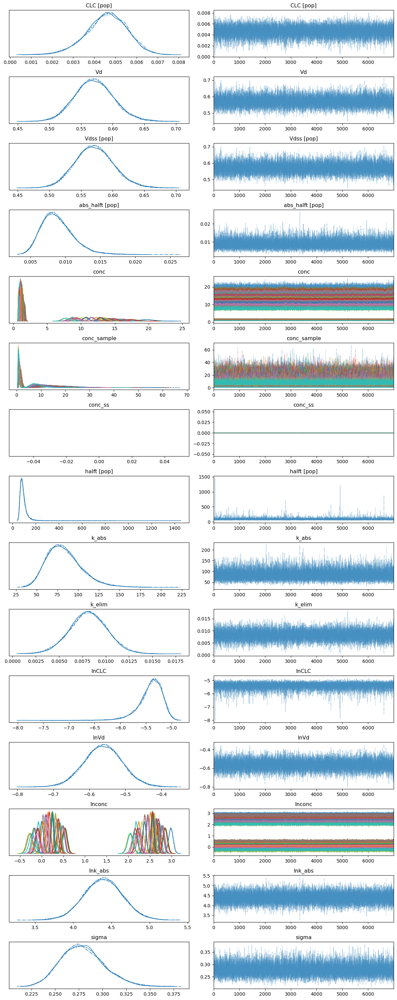

In [38]:
with pfas_male_1cmpt_mouse.model:
    az.plot_trace(pfas_male_1cmpt_mouse._trace)
    plt.tight_layout()

conc_indiv
conc_summary


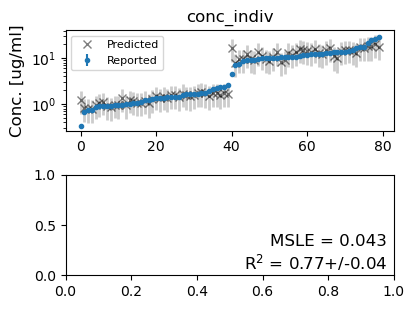

In [39]:
pfas_male_1cmpt_mouse.plot_data_ppc(group='posterior')

#### 2-Compartment model

In [40]:
pfas_male_2cmpt_mouse = PyPKMC(pfas_male_data_mouse, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_male_2cmpt_mouse.sample(model_type='2-compartment', target_accept=0.999, nuts_sampler='numpyro', hierarchy='single',
                             load_trace=load_trace, tune=20000, draws=7000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFNA_Male_mouse_2cmpt
single level model, 2-compartment


Sampling: [conc_indiv, conc_summary, lnCLC, lnR, lnVdss, lnk_abs, lnk_cd, sigma]


  0%|          | 0/27000 [00:00<?, ?it/s]

  0%|          | 0/27000 [00:00<?, ?it/s]

  0%|          | 0/27000 [00:00<?, ?it/s]

  0%|          | 0/27000 [00:00<?, ?it/s]

Sampling: [conc_indiv, conc_summary]


Output()

Combining likelihoods...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


Checking metrics...
Pass all metrics = True
Assign pareto...


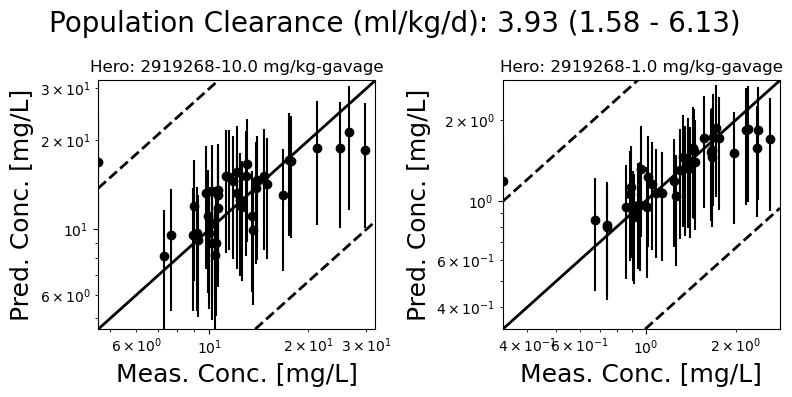

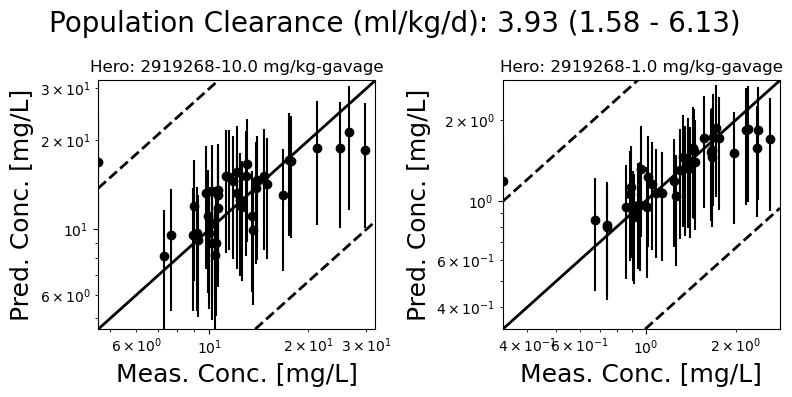

In [41]:
pfas_male_2cmpt_mouse._study_ppc(2919268, continuous=False)

/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (26), generating only 20 plots
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


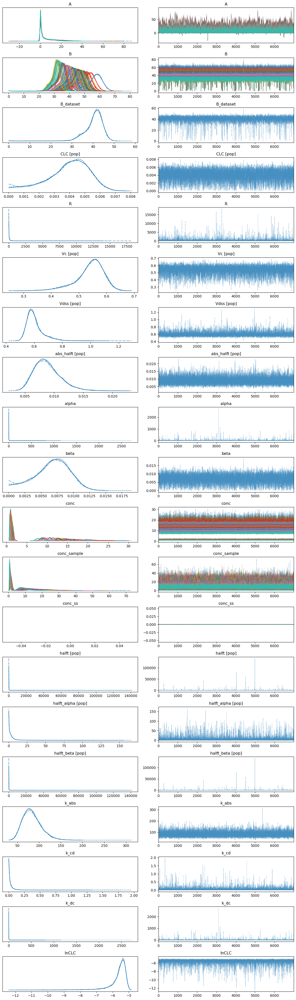

In [42]:
with pfas_male_2cmpt_mouse.model:
    az.plot_trace(pfas_male_2cmpt_mouse._trace)
    plt.tight_layout()

conc_indiv
conc_summary


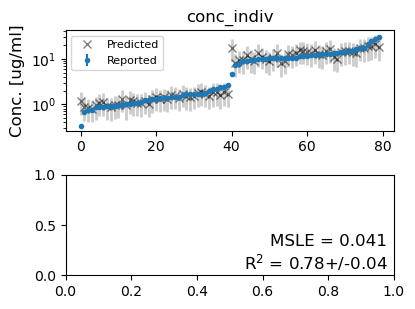

In [43]:
pfas_male_2cmpt_mouse.plot_data_ppc(group='posterior')

#### Compare models

/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
2_compartment,0,-123.873813,8.935955,0.000000,0.682853,19.879430,0.000,True,log
1_compartment,1,-124.051768,7.449060,0.177955,0.317147,19.057902,1.349,False,log


<Axes: title={'center': 'Model comparison\nhigher is better'}, xlabel='elpd_loo (log)', ylabel='ranked models'>

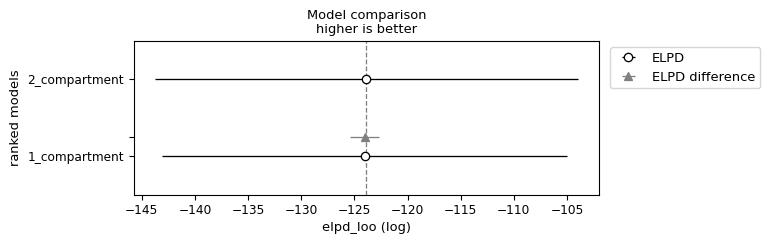

In [44]:
pfas_male_mouse_compare = az.compare({"1_compartment": pfas_male_1cmpt_mouse._trace, "2_compartment": pfas_male_2cmpt_mouse._trace},
                           var_name="combined",ic='loo')
display(pfas_male_mouse_compare)
az.plot_compare(pfas_male_mouse_compare, insample_dev=False)

#### Define winning model

In [72]:
pfas_male_mouse = pfas_male_2cmpt_mouse
print(pfas_male_mouse.N_divergences)
print(f'Pass all metrics = {pfas_male_mouse.pass_all_metrics}')

0
Pass all metrics = True


### Posterior predictive check on winning model

conc_indiv
conc_summary
conc_indiv
conc_summary


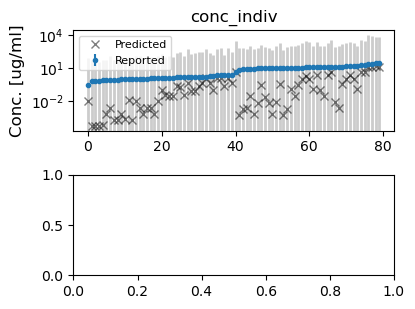

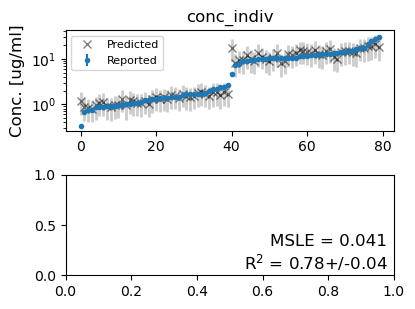

In [46]:
pfas_male_mouse.plot_data_ppc(group='prior', savefig=True)
pfas_male_mouse.plot_data_ppc(group='posterior', savefig=True)

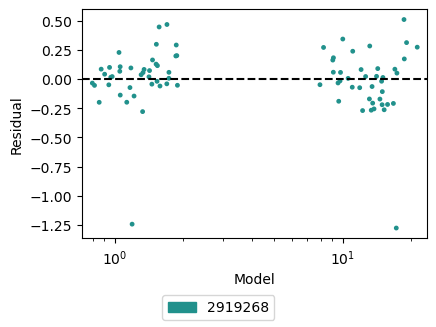

In [47]:
pfas_male_mouse.plot_residuals(y='Residual') 

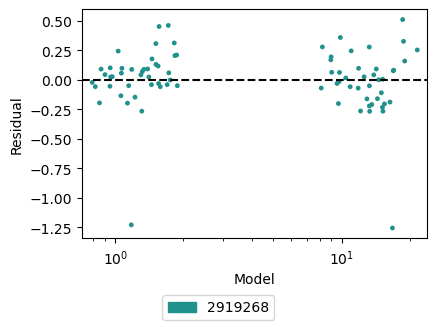

In [48]:
# r = log(obs) - log(pred)
pfas_male_mouse.plot_residuals() 

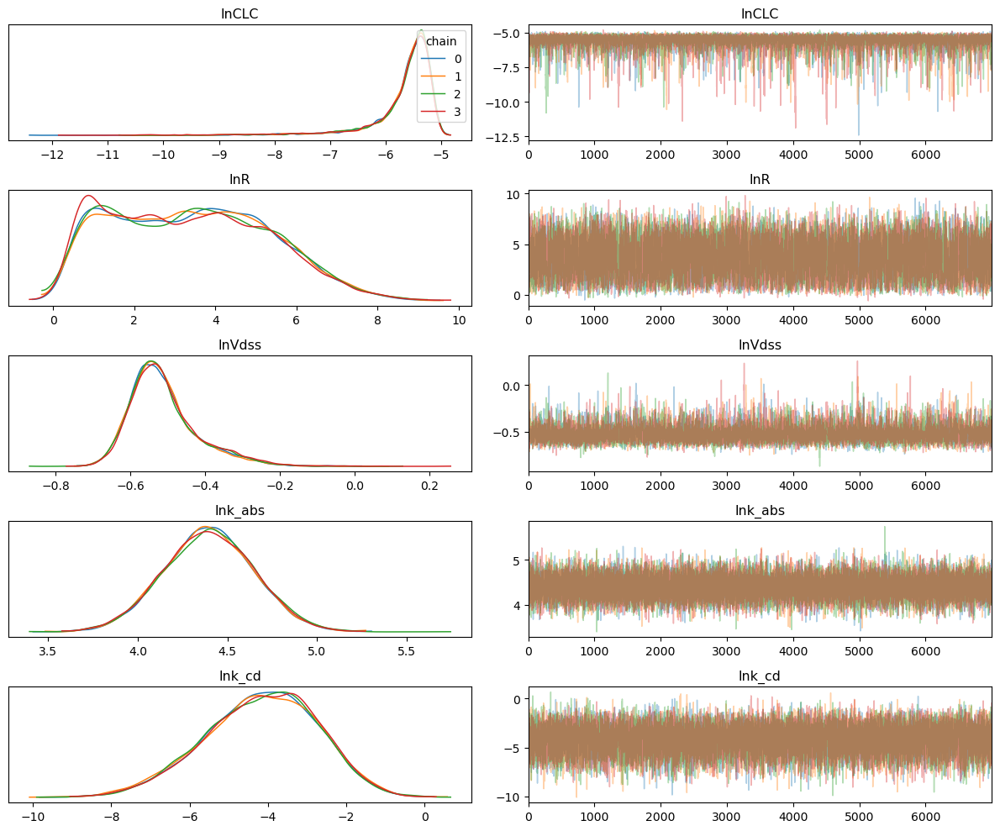

In [49]:
trace_model = pfas_male_mouse
with trace_model.model:
    if trace_model.model_structure == 'hierarchical':
        az.plot_trace(trace_model._trace, var_names=['^mu_ln'], filter_vars='regex', compact=False, legend=True)
    else:
        az.plot_trace(trace_model._trace, var_names=['^ln(?!conc).*$'], filter_vars='regex', compact=False, legend=True)
    plt.tight_layout()
    plt.savefig('../ppc/traceplots/%s_%s_%s_traceplot.png'% (trace_model.chemical, trace_model.species, trace_model.sex))

../species_fits/mouse/PFNA/PFNA_Male_mouse_CLC_2cmpt.pdf
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...


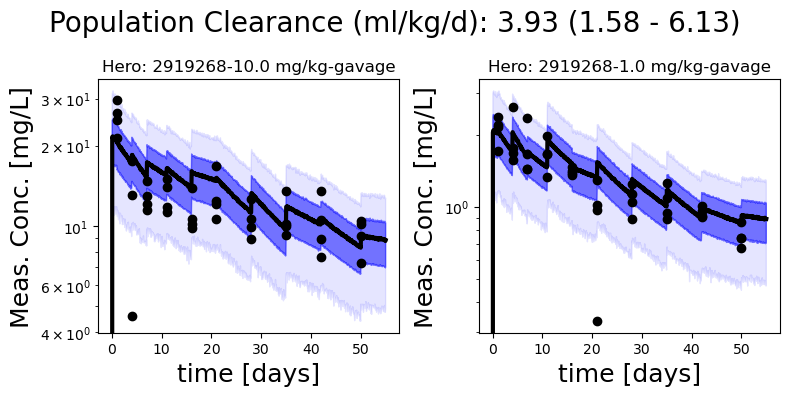

In [50]:
pfas_male_mouse.plot_all_studies()

../species_fits/mouse/PFNA/PFNA_Male_mouse_CLC_2cmpt.pdf


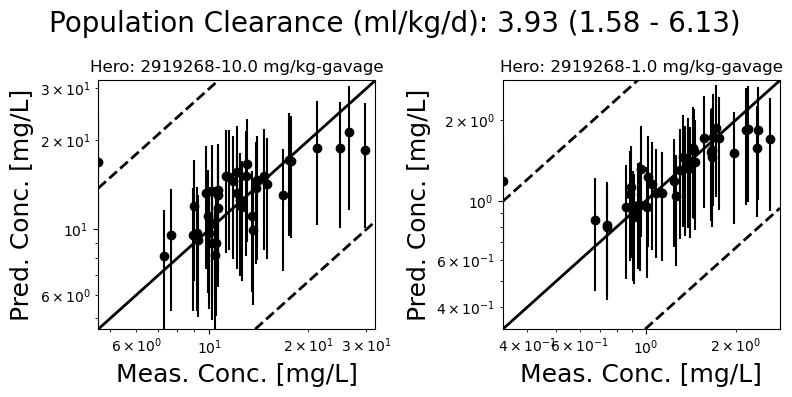

In [51]:
pfas_male_mouse.plot_all_studies(hero_unity=[2919268])

### PK stats

In [52]:
pfas_male_mouse.get_pk_stats(vol_units='ml')

,mean,sd,hdi_5%,hdi_95%
CLC [pop],3.93000,1.38000,1.58000,6.13000
Vc [pop],0.53997,0.05282,0.45516,0.62065
Vdss [pop],602.61000,60.08000,517.31000,693.47000
abs_halft [pop],0.00881,0.00225,0.00532,0.01238
halft [pop],227.45963,1411.47922,51.09838,243.03706
halft_alpha [pop],4.39399,8.73394,0.00025,9.53783
halft_beta [pop],228.97736,1411.85219,49.67511,247.93473


## Female

In [53]:
%%time
pfas_female_data_mouse = pfas_tmp.get_processed_data(chemical=chemical, sex='Female', species='mouse')
pfas_female_data_mouse.head()

Hero ID available:  [2919268 3858670 3859701 5063958]
dropping duplicated column
Hero ID used:  [2919268]
CPU times: user 83.4 ms, sys: 2.75 ms, total: 86.1 ms
Wall time: 85.5 ms


,hero_id,study_id,animal_id,N_animals,BW,BW_units,BW_init,BW_init_units,species,strain,dose,dose_units,time,time_units,conc_mean,conc_sd,standard_error,conc_units,route,matrix,sex,dtxsid,source,initial_age,initial_age_units,initial_weight,initial_weight_units,n,author,preferred_name,pfas_abbrev,casrn,iupac_name,mapped_dtxsid,n_times,idx1,idx2,idx3,time_cor,dose_cor,BW_cor,conc_mean_cor,conc_sd_cor,Dss,lod,censored,route_idx,sex_idx,lnconc_sd,lnconc_mean,cv,aidx,dose_mg,dataset_str
0,2919268,25,7975,1,21.0,g,0.0250,g,mouse,CD-1,1.0,mg/kg,1.0,day,6420.0,0.0,0,ng/ml,gavage,serum,Female,DTXSID8031863,Lau_RawData,9.0,weeks,NaN,Indiv. Reported,1,Tatum-Gibbs,Perfluorononanoic acid,PFNA,375-95-1,"2,2,3,3,4,4,5,5,6,6,7,7,8,8,9,9,9-heptadecaflu...",DTXSID8031863,10,0,0,0,1.0,1.0,0.0210,6.41101,0.0,0.0,-1,0,1,1,0.0,1.858017,0.0,True,0.0250,2919268-1.0 mg/kg-gavage
1,2919268,25,7976,1,24.5,g,0.0249,g,mouse,CD-1,1.0,mg/kg,1.0,day,4510.0,0.0,0,ng/ml,gavage,serum,Female,DTXSID8031863,Lau_RawData,9.0,weeks,NaN,Indiv. Reported,1,Tatum-Gibbs,Perfluorononanoic acid,PFNA,375-95-1,"2,2,3,3,4,4,5,5,6,6,7,7,8,8,9,9,9-heptadecaflu...",DTXSID8031863,10,0,0,0,1.0,1.0,0.0245,4.50101,0.0,0.0,-1,0,1,1,0.0,1.504302,0.0,True,0.0249,2919268-1.0 mg/kg-gavage
2,2919268,25,7977,1,21.2,g,0.0249,g,mouse,CD-1,1.0,mg/kg,1.0,day,6510.0,0.0,0,ng/ml,gavage,serum,Female,DTXSID8031863,Lau_RawData,9.0,weeks,NaN,Indiv. Reported,1,Tatum-Gibbs,Perfluorononanoic acid,PFNA,375-95-1,"2,2,3,3,4,4,5,5,6,6,7,7,8,8,9,9,9-heptadecaflu...",DTXSID8031863,10,0,0,0,1.0,1.0,0.0212,6.50101,0.0,0.0,-1,0,1,1,0.0,1.871958,0.0,True,0.0249,2919268-1.0 mg/kg-gavage
3,2919268,25,7978,1,28.3,g,0.0281,g,mouse,CD-1,1.0,mg/kg,1.0,day,4790.0,0.0,0,ng/ml,gavage,serum,Female,DTXSID8031863,Lau_RawData,9.0,weeks,NaN,Indiv. Reported,1,Tatum-Gibbs,Perfluorononanoic acid,PFNA,375-95-1,"2,2,3,3,4,4,5,5,6,6,7,7,8,8,9,9,9-heptadecaflu...",DTXSID8031863,10,0,0,0,1.0,1.0,0.0283,4.78101,0.0,0.0,-1,0,1,1,0.0,1.564652,0.0,True,0.0281,2919268-1.0 mg/kg-gavage
4,2919268,25,7991,1,27.1,g,0.0264,g,mouse,CD-1,1.0,mg/kg,4.0,day,3545.0,0.0,0,ng/ml,gavage,serum,Female,DTXSID8031863,Lau_RawData,9.0,weeks,NaN,Indiv. Reported,1,Tatum-Gibbs,Perfluorononanoic acid,PFNA,375-95-1,"2,2,3,3,4,4,5,5,6,6,7,7,8,8,9,9,9-heptadecaflu...",DTXSID8031863,10,0,0,0,4.0,1.0,0.0271,3.53601,0.0,0.0,-1,0,1,1,0.0,1.262999,0.0,True,0.0264,2919268-1.0 mg/kg-gavage


### Run the models

#### 1-Compartment model

In [54]:
pfas_female_1cmpt_mouse = PyPKMC(pfas_female_data_mouse, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_female_1cmpt_mouse.sample(model_type='1-compartment', target_accept=0.99, nuts_sampler='numpyro', hierarchy='single',
                             load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFNA_Female_mouse_1cmpt
single level model, 1-compartment


Sampling: [conc_indiv, conc_summary, lnCLC, lnVd, lnk_abs, sigma]


  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

Sampling: [conc_indiv, conc_summary]


Output()

Combining likelihoods...
Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


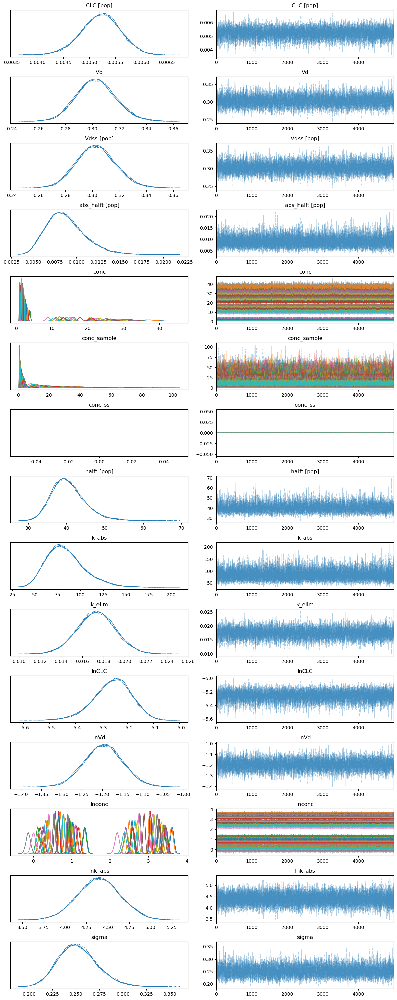

In [55]:
with pfas_female_1cmpt_mouse.model:
    az.plot_trace(pfas_female_1cmpt_mouse._trace)
    plt.tight_layout()

conc_indiv
conc_summary


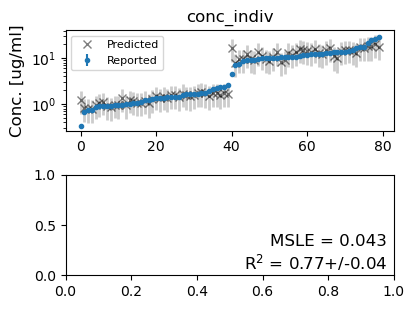

In [56]:
pfas_male_1cmpt_mouse.plot_data_ppc(group='posterior')

#### 2-Compartment model

In [57]:
pfas_female_2cmpt_mouse = PyPKMC(pfas_female_data_mouse, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_female_2cmpt_mouse.sample(model_type='2-compartment', target_accept=0.999, nuts_sampler='numpyro', hierarchy='single',
                             load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFNA_Female_mouse_2cmpt
single level model, 2-compartment


Sampling: [conc_indiv, conc_summary, lnCLC, lnR, lnVdss, lnk_abs, lnk_cd, sigma]


  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

Sampling: [conc_indiv, conc_summary]


Output()

Combining likelihoods...
Checking metrics...
Pass all metrics = True
Assign pareto...


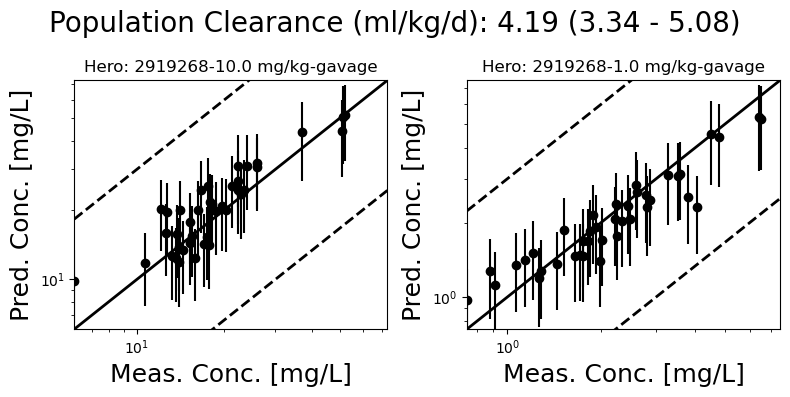

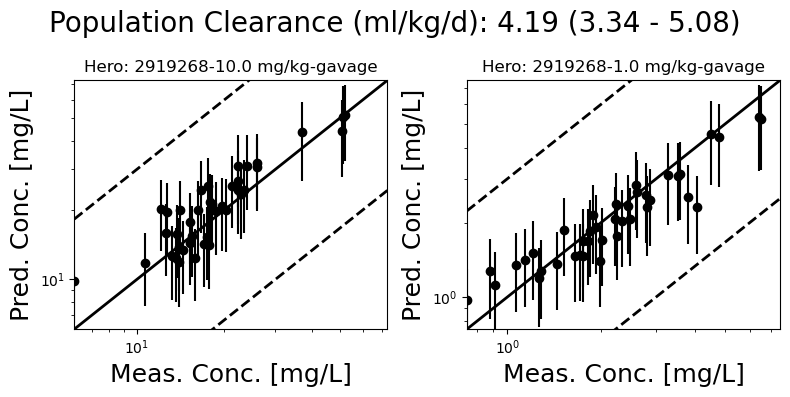

In [58]:
pfas_female_2cmpt_mouse._study_ppc(2919268, continuous=False)

/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (26), generating only 20 plots
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


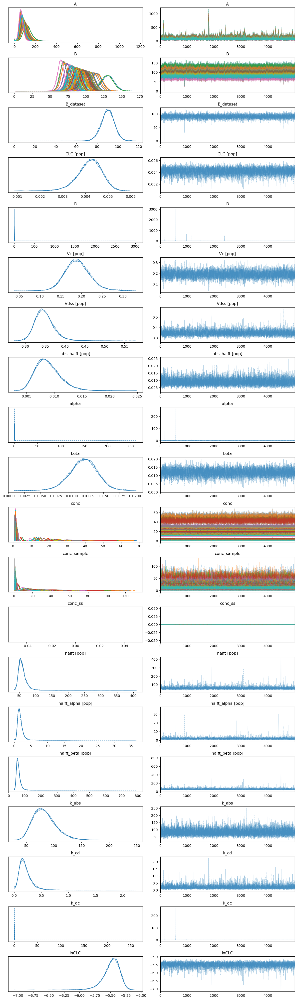

In [59]:
with pfas_female_2cmpt_mouse.model:
    az.plot_trace(pfas_female_2cmpt_mouse._trace)
    plt.tight_layout()

conc_indiv
conc_summary


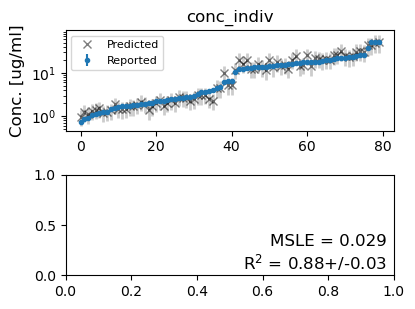

In [60]:
pfas_female_2cmpt_mouse.plot_data_ppc(group='posterior')

#### Compare models

,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
2_compartment,0,-138.566998,4.786882,0.000000,0.982698,12.288355,0.00000,False,log
1_compartment,1,-151.260458,2.815559,12.693461,0.017302,13.052472,4.70135,False,log


<Axes: title={'center': 'Model comparison\nhigher is better'}, xlabel='elpd_loo (log)', ylabel='ranked models'>

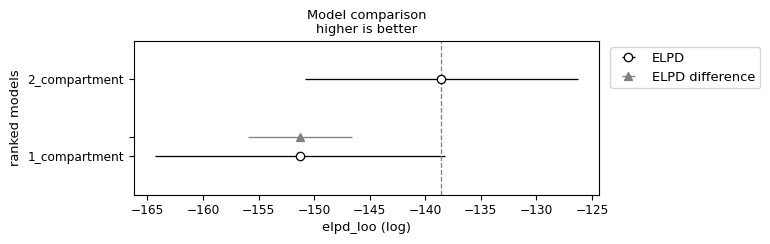

In [61]:
pfas_female_mouse_compare = az.compare({"1_compartment": pfas_female_1cmpt_mouse._trace, "2_compartment": pfas_female_2cmpt_mouse._trace},
                           var_name="combined",ic='loo')
display(pfas_female_mouse_compare)
az.plot_compare(pfas_female_mouse_compare, insample_dev=False)

#### Define winning model

In [73]:
pfas_female_mouse = pfas_female_2cmpt_mouse
print(pfas_female_mouse.N_divergences)
print(f'Pass all metrics = {pfas_female_2cmpt_mouse.pass_all_metrics}')

0
Pass all metrics = True


### Posterior predictive check on winning model

conc_indiv
conc_summary
conc_indiv
conc_summary


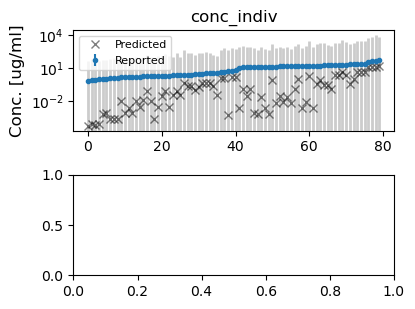

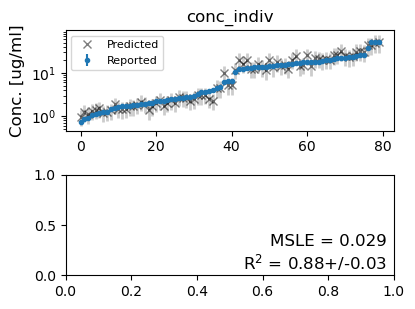

In [63]:
pfas_female_mouse.plot_data_ppc(group='prior', savefig=True)
pfas_female_mouse.plot_data_ppc(group='posterior', savefig=True)

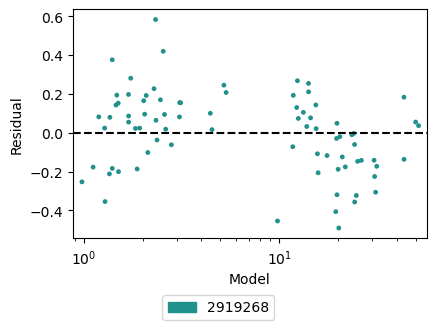

In [64]:
pfas_female_mouse.plot_residuals() 

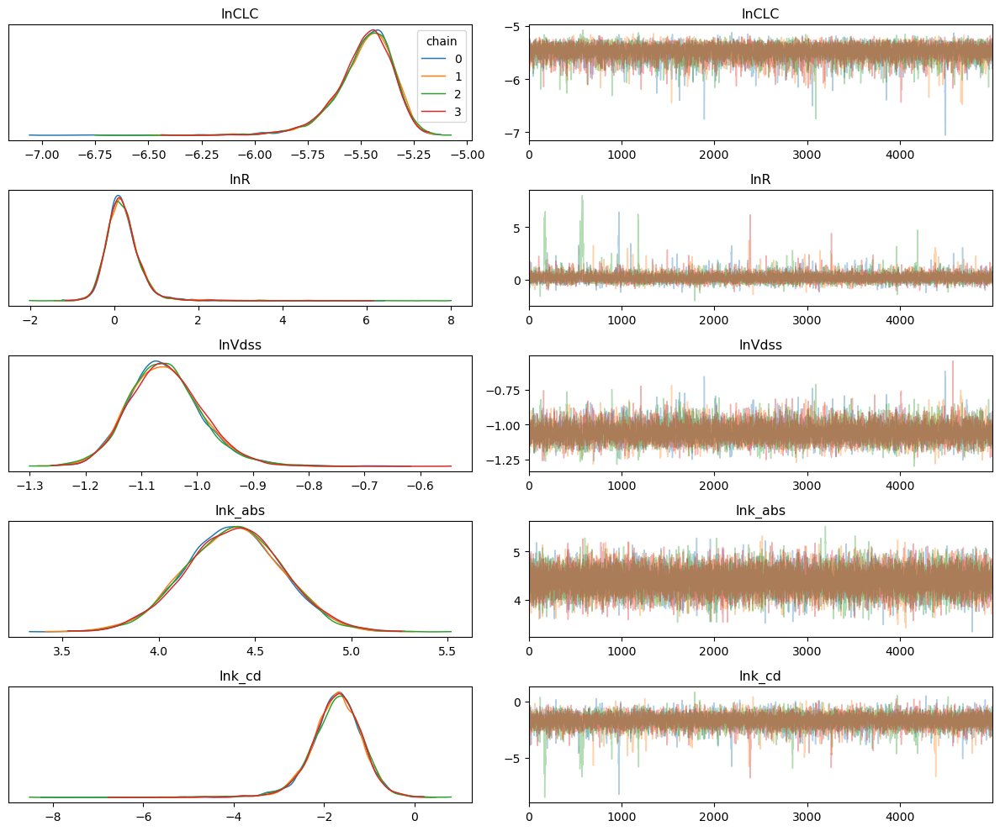

In [65]:
trace_model = pfas_female_mouse
with trace_model.model:
    if trace_model.model_structure == 'hierarchical':
        az.plot_trace(trace_model._trace, var_names=['^mu_ln'], filter_vars='regex', compact=False, legend=True)
    else:
        az.plot_trace(trace_model._trace, var_names=['^ln(?!conc).*$'], filter_vars='regex', compact=False, legend=True)
    plt.tight_layout()
    plt.savefig('../ppc/traceplots/%s_%s_%s_traceplot.png'% (trace_model.chemical, trace_model.species, trace_model.sex))

../species_fits/mouse/PFNA/PFNA_Female_mouse_CLC_2cmpt.pdf
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...


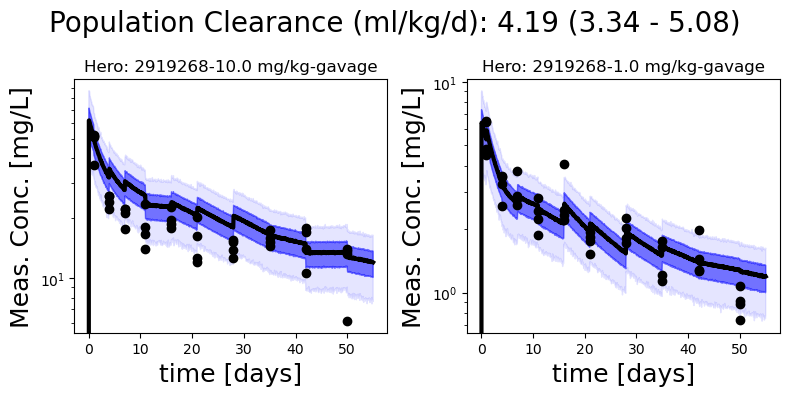

In [66]:
pfas_female_mouse.plot_all_studies()

### PK stats

In [67]:
pfas_female_mouse.get_pk_stats(vol_units='ml') ##

,mean,sd,hdi_5%,hdi_95%
CLC [pop],4.19000,0.55000,3.34000,5.08000
Vc [pop],0.19066,0.03091,0.14205,0.24067
Vdss [pop],348.45000,23.81000,309.89000,384.28000
abs_halft [pop],0.00888,0.00227,0.00529,0.01234
halft [pop],59.43924,14.72244,41.71705,77.12940
halft_alpha [pop],1.84043,1.01674,0.73954,2.94073
halft_beta [pop],61.04029,16.04618,42.85302,79.68054


# Primate

No primate data available for PFNA